Probably using collaborative-based filtering - trying to find similar playlists. If one playlist contained a song, it's likely that the user will like another playlist that contains that song

In [1]:
# imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import seaborn.objects as so

In [2]:
# importing the first json file to explore
import json

# open the JSON file
with open('data/spotify_million_playlist_dataset/data/mpd.slice.0_999.json', 'r') as json_file:
    # Load the JSON data
    slice1 = json.load(json_file)
    print(type(slice1))

<class 'dict'>


In [3]:
# what are the data types and keys?
print(f"The overall data type is {type(slice1)}")
print(f"The keys are {list(slice1.keys())}")

The overall data type is <class 'dict'>
The keys are ['info', 'playlists']


In [4]:
# what are the keys of the info section?
print(f"The keys of the info section are {list(slice1['info'].keys())}")

The keys of the info section are ['generated_on', 'slice', 'version']


In [5]:
# tells you when the playlist was made
slice1['info']['generated_on']

'2017-12-03 08:41:42.057563'

In [6]:
# we already know this
slice1['info']['slice']

'0-999'

In [7]:
# this also doesn't seem very important
slice1['info']['version']

'v1'

In [8]:
# what is the datatype of 'playlists'?
type(slice1['playlists'])

list

In [9]:
# checking out the fifth entry of "playlists"
slice1['playlists'][4]

{'name': '90s',
 'collaborative': 'false',
 'pid': 4,
 'modified_at': 1401667200,
 'num_tracks': 17,
 'num_albums': 16,
 'num_followers': 2,
 'tracks': [{'pos': 0,
   'artist_name': 'The Smashing Pumpkins',
   'track_uri': 'spotify:track:4iCGSi1RonREsPtfEKYj5b',
   'artist_uri': 'spotify:artist:40Yq4vzPs9VNUrIBG5Jr2i',
   'track_name': 'Tonight, Tonight',
   'album_uri': 'spotify:album:4bPT6Q8ppaSNppk1kbEbLl',
   'duration_ms': 254626,
   'album_name': 'Mellon Collie and the Infinite Sadness'},
  {'pos': 1,
   'artist_name': 'Oasis',
   'track_uri': 'spotify:track:5qqabIl2vWzo9ApSC317sa',
   'artist_uri': 'spotify:artist:2DaxqgrOhkeH0fpeiQq2f4',
   'track_name': 'Wonderwall - Remastered',
   'album_uri': 'spotify:album:1VW1MFNstaJuygaoTPkdCk',
   'duration_ms': 258773,
   'album_name': "(What's The Story) Morning Glory? [Remastered]"},
  {'pos': 2,
   'artist_name': 'Aerosmith',
   'track_uri': 'spotify:track:0c1gHntWjKD7QShC8s99sq',
   'artist_uri': 'spotify:artist:7Ey4PD4MYsKc5I2dolU

In [10]:
# isolating the first track of the first playlist
slice1['playlists'][0]['tracks'][0]

{'pos': 0,
 'artist_name': 'Missy Elliott',
 'track_uri': 'spotify:track:0UaMYEvWZi0ZqiDOoHU3YI',
 'artist_uri': 'spotify:artist:2wIVse2owClT7go1WT98tk',
 'track_name': 'Lose Control (feat. Ciara & Fat Man Scoop)',
 'album_uri': 'spotify:album:6vV5UrXcfyQD1wu4Qo2I9K',
 'duration_ms': 226863,
 'album_name': 'The Cookbook'}

In [11]:
# checking out the last song on the last playlist in this file
slice1['playlists'][999]['tracks'][43]

{'pos': 43,
 'artist_name': 'Grizfolk',
 'track_uri': 'spotify:track:5RVuBrXVLptAEbGJdSDzL5',
 'artist_uri': 'spotify:artist:6Xa4nbrSTfbioA4lLShbjh',
 'track_name': 'Cosmic Angel - Acoustic From Capitol Studios',
 'album_uri': 'spotify:album:7D6Y19tjm4DQNch39FeWpO',
 'duration_ms': 257194,
 'album_name': 'Cosmic Angel'}

In [12]:
# saving just the playlists and not the info
playlists_list_1 = slice1['playlists']
type(playlists_list_1)

list

In [13]:
# turning the playlists list into a dataframe, with the "tracks" column containing a list of tracks in each playlist
playlists_1 = pd.DataFrame(playlists_list_1)
playlists_1.head()

,name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,tracks,num_edits,duration_ms,num_artists,description
0,Throwbacks,false,0,1493424000,52,47,1,"[{'pos': 0, 'artist_name': 'Missy Elliott', 't...",6,11532414,37,NaN
1,Awesome Playlist,false,1,1506556800,39,23,1,"[{'pos': 0, 'artist_name': 'Survivor', 'track_...",5,11656470,21,NaN
2,korean,false,2,1505692800,64,51,1,"[{'pos': 0, 'artist_name': 'Hoody', 'track_uri...",18,14039958,31,NaN
3,mat,false,3,1501027200,126,107,1,"[{'pos': 0, 'artist_name': 'Camille Saint-Saën...",4,28926058,86,NaN
4,90s,false,4,1401667200,17,16,2,"[{'pos': 0, 'artist_name': 'The Smashing Pumpk...",7,4335282,16,NaN


In [14]:
playlists_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   name           1000 non-null   object
 1   collaborative  1000 non-null   object
 2   pid            1000 non-null   int64 
 3   modified_at    1000 non-null   int64 
 4   num_tracks     1000 non-null   int64 
 5   num_albums     1000 non-null   int64 
 6   num_followers  1000 non-null   int64 
 7   tracks         1000 non-null   object
 8   num_edits      1000 non-null   int64 
 9   duration_ms    1000 non-null   int64 
 10  num_artists    1000 non-null   int64 
 11  description    20 non-null     object
dtypes: int64(8), object(4)
memory usage: 93.9+ KB


# INITIAL THOUGHTS
Just from the above, my initial thoughts are to:
    - change "modified_at" to date/time
    - remove the "description" column 

Before we get too far, let's read in more data and concatenate them together

In [15]:
# function to load in .json files

def load_slices(start, end):
    slice_list = []
    for i in range(start, end + 1):
        file_path = f"data/spotify_million_playlist_dataset/data/mpd.slice.{i*1000}-{(i+1)*1000-1}.json"
        with open(file_path, 'r') as json_file:
            slice_data = json.load(json_file)
            slice_list.append(slice_data)
        print(f"slice{i} loaded")
    return slice_list

In [16]:
# loading in slices 2-20
slice_list = load_slices(2, 10)

slice2 loaded
slice3 loaded
slice4 loaded
slice5 loaded
slice6 loaded
slice7 loaded
slice8 loaded
slice9 loaded
slice10 loaded


In [17]:
slice_list[0]

{'info': {'generated_on': '2017-12-03 08:41:42.057563',
  'slice': '2000-2999',
  'version': 'v1'},
 'playlists': [{'name': 'party party',
   'collaborative': 'false',
   'pid': 2000,
   'modified_at': 1446854400,
   'num_tracks': 152,
   'num_albums': 142,
   'num_followers': 1,
   'tracks': [{'pos': 0,
     'artist_name': 'The Jackson 5',
     'track_uri': 'spotify:track:6cb0HzFQPN4BGADOmSzPCw',
     'artist_uri': 'spotify:artist:2iE18Oxc8YSumAU232n4rW',
     'track_name': 'ABC',
     'album_uri': 'spotify:album:4GuzZh2dtsOjG3sMkx52eR',
     'duration_ms': 174866,
     'album_name': 'ABC'},
    {'pos': 1,
     'artist_name': 'Streetlight Manifesto',
     'track_uri': 'spotify:track:0HBvwy7XVhrkQljkCONgsq',
     'artist_uri': 'spotify:artist:1OKOTYGoCE2buxTYMegJp7',
     'track_name': 'Point/Counterpoint',
     'album_uri': 'spotify:album:3phH2ZoACvpLVcPtyIk8jp',
     'duration_ms': 327920,
     'album_name': 'Everything Goes Numb'},
    {'pos': 2,
     'artist_name': 'Michael Jackson

In [18]:
# adding slice 1 to this list, since we already read it in separately
slice_list.append(slice1)

In [19]:
# converting each of the slices into a dataframe and concatenating them together
def convert_and_concat_slices(slice_data_list):
    all_playlists_dfs = []  # List to store DataFrames for each slice's playlists
    
    # Iterate over each slice's data
    for slice_data in slice_data_list:
        playlists_list = slice_data['playlists']  # Get the playlists list from the slice
        playlists_df = pd.DataFrame(playlists_list)  # Convert playlists list to DataFrame
        all_playlists_dfs.append(playlists_df)  # Append DataFrame to list
    
    # Concatenate all DataFrames into one
    concatenated_df = pd.concat(all_playlists_dfs, ignore_index=True)
    
    print('All playlists converted and concatenated successfully!')
    return concatenated_df

In [20]:
# running our function on our list of slices we read in
df = convert_and_concat_slices(slice_list)
df.info()

All playlists converted and concatenated successfully!
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   name           10000 non-null  object
 1   collaborative  10000 non-null  object
 2   pid            10000 non-null  int64 
 3   modified_at    10000 non-null  int64 
 4   num_tracks     10000 non-null  int64 
 5   num_albums     10000 non-null  int64 
 6   num_followers  10000 non-null  int64 
 7   tracks         10000 non-null  object
 8   num_edits      10000 non-null  int64 
 9   duration_ms    10000 non-null  int64 
 10  num_artists    10000 non-null  int64 
 11  description    202 non-null    object
dtypes: int64(8), object(4)
memory usage: 937.6+ KB


In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   name           10000 non-null  object
 1   collaborative  10000 non-null  object
 2   pid            10000 non-null  int64 
 3   modified_at    10000 non-null  int64 
 4   num_tracks     10000 non-null  int64 
 5   num_albums     10000 non-null  int64 
 6   num_followers  10000 non-null  int64 
 7   tracks         10000 non-null  object
 8   num_edits      10000 non-null  int64 
 9   duration_ms    10000 non-null  int64 
 10  num_artists    10000 non-null  int64 
 11  description    202 non-null    object
dtypes: int64(8), object(4)
memory usage: 937.6+ KB


In [22]:
columns_to_drop = ['num_edits', 'description']
df = df.drop(columns_to_drop, axis = 1)

In [23]:
df.head()

,name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,tracks,duration_ms,num_artists
0,party party,false,2000,1446854400,152,142,1,"[{'pos': 0, 'artist_name': 'The Jackson 5', 't...",39413578,116
1,summer,false,2001,1495584000,11,10,1,"[{'pos': 0, 'artist_name': 'Ruth B.', 'track_u...",2386978,9
2,Rap,false,2002,1509235200,221,128,4,"[{'pos': 0, 'artist_name': 'Bankroll Mafia', '...",47356150,84
3,#tb,false,2003,1477785600,35,33,1,"[{'pos': 0, 'artist_name': 'Elvis Presley', 't...",6630645,26
4,Disney,false,2004,1500940800,20,19,1,"[{'pos': 0, 'artist_name': 'Ariana Grande', 't...",3716605,19


In [24]:
df.tail()

,name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,tracks,duration_ms,num_artists
9995,old,false,995,1507852800,41,40,1,"[{'pos': 0, 'artist_name': 'Katrina', 'track_u...",9917901,36
9996,Daze,false,996,1479254400,17,17,1,"[{'pos': 0, 'artist_name': 'PARTYNEXTDOOR', 't...",3699248,15
9997,rap,false,997,1410307200,119,98,1,"[{'pos': 0, 'artist_name': 'LoveRance', 'track...",27538723,82
9998,Country,false,998,1507939200,108,75,1,"[{'pos': 0, 'artist_name': 'Hunter Hayes', 'tr...",24950143,40
9999,thinking of you,false,999,1507766400,44,43,1,"[{'pos': 0, 'artist_name': 'Pvris', 'track_uri...",9065801,37


Looking at each column individually

In [25]:
df['collaborative'].value_counts()

collaborative
false    9785
true      215
Name: count, dtype: int64

In [26]:
df['num_tracks'].describe()

count    10000.000000
mean        66.473800
std         53.575727
min          5.000000
25%         26.000000
50%         50.000000
75%         91.000000
max        250.000000
Name: num_tracks, dtype: float64

In [27]:
df['num_albums'].describe()

count    10000.000000
mean        49.732000
std         39.809462
min          2.000000
25%         20.000000
50%         38.000000
75%         68.000000
max        233.000000
Name: num_albums, dtype: float64

In [28]:
df['num_followers'].describe()

count    10000.000000
mean         3.482800
std        161.031022
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max      15842.000000
Name: num_followers, dtype: float64

In [29]:
df['num_artists'].describe()

count    10000.000000
mean        38.254200
std         30.222044
min          3.000000
25%         16.000000
50%         30.000000
75%         52.000000
max        199.000000
Name: num_artists, dtype: float64

In [30]:
df['duration_ms'].head()

0    39413578
1     2386978
2    47356150
3     6630645
4     3716605
Name: duration_ms, dtype: int64

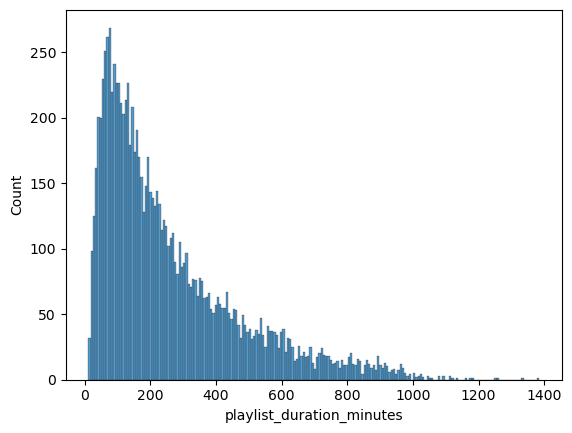

In [31]:
# what's the average length of a playlist?
df['playlist_duration_minutes'] = df['duration_ms'] / 60000

# Plotting the histogram
sns.histplot(df['playlist_duration_minutes'], bins=200);

In [32]:
df['tracks'][1][0]

{'pos': 0,
 'artist_name': 'Ruth B.',
 'track_uri': 'spotify:track:359ofvoEja4de0XjzUL3D5',
 'artist_uri': 'spotify:artist:2WzaAvm2bBCf4pEhyuDgCY',
 'track_name': 'If This is Love',
 'album_uri': 'spotify:album:6FgtuX3PtiB5civjHYhc52',
 'duration_ms': 229600,
 'album_name': 'Safe Haven'}

In [33]:
df['tracks'][1][0].keys()

dict_keys(['pos', 'artist_name', 'track_uri', 'artist_uri', 'track_name', 'album_uri', 'duration_ms', 'album_name'])

In [34]:
# for Tableau purposes
#df.to_csv('df.csv', index=True)

In [35]:
# to flatten the lists
df_tracks_exploded = df.explode('tracks')
df_tracks_exploded.head()

,name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,tracks,duration_ms,num_artists,playlist_duration_minutes
0,party party,false,2000,1446854400,152,142,1,"{'pos': 0, 'artist_name': 'The Jackson 5', 'tr...",39413578,116,656.892967
0,party party,false,2000,1446854400,152,142,1,"{'pos': 1, 'artist_name': 'Streetlight Manifes...",39413578,116,656.892967
0,party party,false,2000,1446854400,152,142,1,"{'pos': 2, 'artist_name': 'Michael Jackson', '...",39413578,116,656.892967
0,party party,false,2000,1446854400,152,142,1,"{'pos': 3, 'artist_name': 'Green Day', 'track_...",39413578,116,656.892967
0,party party,false,2000,1446854400,152,142,1,"{'pos': 4, 'artist_name': 'The White Stripes',...",39413578,116,656.892967


In [36]:
# checking to see how large our dataset is now that each track in each playlist has its own row
df_tracks_exploded.info()

<class 'pandas.core.frame.DataFrame'>
Index: 664738 entries, 0 to 9999
Data columns (total 11 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   name                       664738 non-null  object 
 1   collaborative              664738 non-null  object 
 2   pid                        664738 non-null  int64  
 3   modified_at                664738 non-null  int64  
 4   num_tracks                 664738 non-null  int64  
 5   num_albums                 664738 non-null  int64  
 6   num_followers              664738 non-null  int64  
 7   tracks                     664738 non-null  object 
 8   duration_ms                664738 non-null  int64  
 9   num_artists                664738 non-null  int64  
 10  playlist_duration_minutes  664738 non-null  float64
dtypes: float64(1), int64(7), object(3)
memory usage: 60.9+ MB


In [37]:
df_tracks_exploded['tracks'][0:5]

0    {'pos': 0, 'artist_name': 'The Jackson 5', 'tr...
0    {'pos': 1, 'artist_name': 'Streetlight Manifes...
0    {'pos': 2, 'artist_name': 'Michael Jackson', '...
0    {'pos': 3, 'artist_name': 'Green Day', 'track_...
0    {'pos': 4, 'artist_name': 'The White Stripes',...
Name: tracks, dtype: object

In [38]:
df_tracks_exploded = df_tracks_exploded.rename(columns={"name": "playlist_name", "duration_ms":"playlist_duration_ms"})
df_tracks_exploded.info()

<class 'pandas.core.frame.DataFrame'>
Index: 664738 entries, 0 to 9999
Data columns (total 11 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   playlist_name              664738 non-null  object 
 1   collaborative              664738 non-null  object 
 2   pid                        664738 non-null  int64  
 3   modified_at                664738 non-null  int64  
 4   num_tracks                 664738 non-null  int64  
 5   num_albums                 664738 non-null  int64  
 6   num_followers              664738 non-null  int64  
 7   tracks                     664738 non-null  object 
 8   playlist_duration_ms       664738 non-null  int64  
 9   num_artists                664738 non-null  int64  
 10  playlist_duration_minutes  664738 non-null  float64
dtypes: float64(1), int64(7), object(3)
memory usage: 60.9+ MB


In [39]:
import time

def expand_dict_column(df, dict_column_name):
    start_time = time.time()  # Record start time
    expanded_df = pd.concat([df.drop([dict_column_name], axis=1), 
                             df[dict_column_name].apply(pd.Series)], axis=1)
    end_time = time.time()  # Record end time
    execution_time = end_time - start_time  # Calculate execution time
    print("Execution time:", execution_time)  # Print execution time
    return expanded_df

In [40]:
expanded_df = expand_dict_column(df_tracks_exploded, 'tracks')
expanded_df.head()

Execution time: 50.563027143478394


,playlist_name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,playlist_duration_ms,num_artists,playlist_duration_minutes,pos,artist_name,track_uri,artist_uri,track_name,album_uri,duration_ms,album_name
0,party party,false,2000,1446854400,152,142,1,39413578,116,656.892967,0,The Jackson 5,spotify:track:6cb0HzFQPN4BGADOmSzPCw,spotify:artist:2iE18Oxc8YSumAU232n4rW,ABC,spotify:album:4GuzZh2dtsOjG3sMkx52eR,174866,ABC
0,party party,false,2000,1446854400,152,142,1,39413578,116,656.892967,1,Streetlight Manifesto,spotify:track:0HBvwy7XVhrkQljkCONgsq,spotify:artist:1OKOTYGoCE2buxTYMegJp7,Point/Counterpoint,spotify:album:3phH2ZoACvpLVcPtyIk8jp,327920,Everything Goes Numb
0,party party,false,2000,1446854400,152,142,1,39413578,116,656.892967,2,Michael Jackson,spotify:track:5ChkMS8OtdzJeqyybCc9R5,spotify:artist:3fMbdgg4jU18AjLCKBhRSm,Billie Jean,spotify:album:1C2h7mLntPSeVYciMRTF4a,293826,Thriller 25 Super Deluxe Edition
0,party party,false,2000,1446854400,152,142,1,39413578,116,656.892967,3,Green Day,spotify:track:6L89mwZXSOwYl76YXfX13s,spotify:artist:7oPftvlwr6VrsViSDV7fJY,Basket Case,spotify:album:4uG8q3GPuWHQlRbswMIRS6,181533,Dookie
0,party party,false,2000,1446854400,152,142,1,39413578,116,656.892967,4,The White Stripes,spotify:track:1jNOi6m3Hn8nLEeHCp5Msr,spotify:artist:4F84IBURUo98rz4r61KF70,Seven Nation Army,spotify:album:4teFaDSeFHYXZjZJaZGrAO,231800,Elephant


In [41]:
expanded_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 664738 entries, 0 to 9999
Data columns (total 18 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   playlist_name              664738 non-null  object 
 1   collaborative              664738 non-null  object 
 2   pid                        664738 non-null  int64  
 3   modified_at                664738 non-null  int64  
 4   num_tracks                 664738 non-null  int64  
 5   num_albums                 664738 non-null  int64  
 6   num_followers              664738 non-null  int64  
 7   playlist_duration_ms       664738 non-null  int64  
 8   num_artists                664738 non-null  int64  
 9   playlist_duration_minutes  664738 non-null  float64
 10  pos                        664738 non-null  int64  
 11  artist_name                664738 non-null  object 
 12  track_uri                  664738 non-null  object 
 13  artist_uri                 664738 no

In [42]:
expanded_df.tail()

,playlist_name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,playlist_duration_ms,num_artists,playlist_duration_minutes,pos,artist_name,track_uri,artist_uri,track_name,album_uri,duration_ms,album_name
9999,thinking of you,false,999,1507766400,44,43,1,9065801,37,151.096683,39,James Arthur,spotify:track:5uCax9HTNlzGybIStD3vDh,spotify:artist:4IWBUUAFIplrNtaOHcJPRM,Say You Won't Let Go,spotify:album:7oiJYvEJHsmYtrgviAVIBD,211466,Back from the Edge
9999,thinking of you,false,999,1507766400,44,43,1,9065801,37,151.096683,40,Big Words,spotify:track:0P1oO2gREMYUCoOkzYAyFu,spotify:artist:0sHN89qak07mnug3LVVjzP,The Answer,spotify:album:5jrsRHRAmetu5e7RRBoxj7,263679,"Hollywood, a Beautiful Coincidence"
9999,thinking of you,false,999,1507766400,44,43,1,9065801,37,151.096683,41,Allan Rayman,spotify:track:2oM4BuruDnEvk59IvIXCwn,spotify:artist:6Yv6OBXD6ZQakEljaGaDAk,25.22,spotify:album:3CbNgBzI7r9o0F6VjH9sTY,189213,Roadhouse 01
9999,thinking of you,false,999,1507766400,44,43,1,9065801,37,151.096683,42,Jon Jason,spotify:track:4Ri5TTUgjM96tbQZd5Ua7V,spotify:artist:77bNdkKYBBmc30CisCA6tE,Good Feeling,spotify:album:2dZ7oVNQBeLlpoUYfbEsJP,194720,Good Feeling
9999,thinking of you,false,999,1507766400,44,43,1,9065801,37,151.096683,43,Grizfolk,spotify:track:5RVuBrXVLptAEbGJdSDzL5,spotify:artist:6Xa4nbrSTfbioA4lLShbjh,Cosmic Angel - Acoustic From Capitol Studios,spotify:album:7D6Y19tjm4DQNch39FeWpO,257194,Cosmic Angel


In [43]:
'''
# Convert the Unix timestamp to a datetime object
expanded_df["modified_date_time"] = pd.to_datetime(expanded_df['modified_at'], unit='s')

# Extract only the date part for each value in the column
expanded_df["modified_date"] = expanded_df["modified_date_time"].dt.date

# Drop the intermediate column
to_drop = ['modified_date_time', 'modified_at']
expanded_df = expanded_df.drop(to_drop, axis=1)

expanded_df.head(1)
'''

'\n# Convert the Unix timestamp to a datetime object\nexpanded_df["modified_date_time"] = pd.to_datetime(expanded_df[\'modified_at\'], unit=\'s\')\n\n# Extract only the date part for each value in the column\nexpanded_df["modified_date"] = expanded_df["modified_date_time"].dt.date\n\n# Drop the intermediate column\nto_drop = [\'modified_date_time\', \'modified_at\']\nexpanded_df = expanded_df.drop(to_drop, axis=1)\n\nexpanded_df.head(1)\n'

In [44]:
expanded_df = expanded_df.rename(columns={"duration_ms": "song_duration_ms"})
expanded_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 664738 entries, 0 to 9999
Data columns (total 18 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   playlist_name              664738 non-null  object 
 1   collaborative              664738 non-null  object 
 2   pid                        664738 non-null  int64  
 3   modified_at                664738 non-null  int64  
 4   num_tracks                 664738 non-null  int64  
 5   num_albums                 664738 non-null  int64  
 6   num_followers              664738 non-null  int64  
 7   playlist_duration_ms       664738 non-null  int64  
 8   num_artists                664738 non-null  int64  
 9   playlist_duration_minutes  664738 non-null  float64
 10  pos                        664738 non-null  int64  
 11  artist_name                664738 non-null  object 
 12  track_uri                  664738 non-null  object 
 13  artist_uri                 664738 no

In [45]:
'''
# convert milliseconds to seconds
def milliseconds_to_time(milliseconds):
    seconds = milliseconds / 1000
    return pd.to_datetime(seconds, unit='s').time()

# Apply the function to convert milliseconds to time
expanded_df['playlist_length'] = expanded_df['playlist_duration_ms'].apply(milliseconds_to_time)

# Drop the intermediate column
expanded_df.drop(columns=['playlist_duration_ms'], inplace=True)
'''

"\n# convert milliseconds to seconds\ndef milliseconds_to_time(milliseconds):\n    seconds = milliseconds / 1000\n    return pd.to_datetime(seconds, unit='s').time()\n\n# Apply the function to convert milliseconds to time\nexpanded_df['playlist_length'] = expanded_df['playlist_duration_ms'].apply(milliseconds_to_time)\n\n# Drop the intermediate column\nexpanded_df.drop(columns=['playlist_duration_ms'], inplace=True)\n"

In [46]:
expanded_df.iloc[27]

playlist_name                                          party party
collaborative                                                false
pid                                                           2000
modified_at                                             1446854400
num_tracks                                                     152
num_albums                                                     142
num_followers                                                    1
playlist_duration_ms                                      39413578
num_artists                                                    116
playlist_duration_minutes                               656.892967
pos                                                             27
artist_name                                          Martin Garrix
track_uri                     spotify:track:6JEntXLt4z98CcDtIH9sU7
artist_uri                   spotify:artist:60d24wfXkVzDSfLS6hyCjZ
track_name                                      Animals - Exte

In [47]:
# creating a column with the combined track name and artist name for ease of understanding
expanded_df["track_and_artist"] = expanded_df.apply(lambda row: f"'{row['track_name']}' by {row['artist_name']}", axis=1)
expanded_df.head(1)

,playlist_name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,playlist_duration_ms,num_artists,playlist_duration_minutes,pos,artist_name,track_uri,artist_uri,track_name,album_uri,song_duration_ms,album_name,track_and_artist
0,party party,false,2000,1446854400,152,142,1,39413578,116,656.892967,0,The Jackson 5,spotify:track:6cb0HzFQPN4BGADOmSzPCw,spotify:artist:2iE18Oxc8YSumAU232n4rW,ABC,spotify:album:4GuzZh2dtsOjG3sMkx52eR,174866,ABC,'ABC' by The Jackson 5


In [48]:
'''
# repeating for the song_duration column
# Apply the function to convert milliseconds to time
expanded_df['song_length'] = expanded_df['song_duration_ms'].apply(milliseconds_to_time)


# Drop the intermediate column 
expanded_df.drop(columns=['song_duration_ms'], inplace=True)
'''

"\n# repeating for the song_duration column\n# Apply the function to convert milliseconds to time\nexpanded_df['song_length'] = expanded_df['song_duration_ms'].apply(milliseconds_to_time)\n\n\n# Drop the intermediate column \nexpanded_df.drop(columns=['song_duration_ms'], inplace=True)\n"

In [49]:
expanded_df.loc[expanded_df["track_name"] == "45"][:5]

,playlist_name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,playlist_duration_ms,num_artists,playlist_duration_minutes,pos,artist_name,track_uri,artist_uri,track_name,album_uri,song_duration_ms,album_name,track_and_artist
160,Hard Rock,false,2160,1465344000,131,69,1,29434314,21,490.571900,5,Shinedown,spotify:track:420JGkyLfLUZcgBHKiIK9v,spotify:artist:70BYFdaZbEKbeauJ670ysI,45,spotify:album:0gLVNSNAW4ghjFqHMDFA3l,250093,Leave A Whisper,'45' by Shinedown
390,Mix,false,2390,1449619200,226,139,2,51429354,59,857.155900,92,Shinedown,spotify:track:420JGkyLfLUZcgBHKiIK9v,spotify:artist:70BYFdaZbEKbeauJ670ysI,45,spotify:album:0gLVNSNAW4ghjFqHMDFA3l,250093,Leave A Whisper,'45' by Shinedown
422,Rock,false,2422,1503878400,159,146,2,35905169,131,598.419483,127,Shinedown,spotify:track:420JGkyLfLUZcgBHKiIK9v,spotify:artist:70BYFdaZbEKbeauJ670ysI,45,spotify:album:0gLVNSNAW4ghjFqHMDFA3l,250093,Leave A Whisper,'45' by Shinedown
832,rock,false,2832,1508976000,187,108,1,42521299,69,708.688317,127,Shinedown,spotify:track:420JGkyLfLUZcgBHKiIK9v,spotify:artist:70BYFdaZbEKbeauJ670ysI,45,spotify:album:0gLVNSNAW4ghjFqHMDFA3l,250093,Leave A Whisper,'45' by Shinedown
854,Amaranthe,false,2854,1498867200,40,31,1,9377296,18,156.288267,27,Shinedown,spotify:track:420JGkyLfLUZcgBHKiIK9v,spotify:artist:70BYFdaZbEKbeauJ670ysI,45,spotify:album:0gLVNSNAW4ghjFqHMDFA3l,250093,Leave A Whisper,'45' by Shinedown


In [50]:
expanded_df.head(1)

,playlist_name,collaborative,pid,modified_at,num_tracks,num_albums,num_followers,playlist_duration_ms,num_artists,playlist_duration_minutes,pos,artist_name,track_uri,artist_uri,track_name,album_uri,song_duration_ms,album_name,track_and_artist
0,party party,false,2000,1446854400,152,142,1,39413578,116,656.892967,0,The Jackson 5,spotify:track:6cb0HzFQPN4BGADOmSzPCw,spotify:artist:2iE18Oxc8YSumAU232n4rW,ABC,spotify:album:4GuzZh2dtsOjG3sMkx52eR,174866,ABC,'ABC' by The Jackson 5


In [51]:
# also for tableau purposes
#expanded_df.to_csv('fdf.csv', index=True)

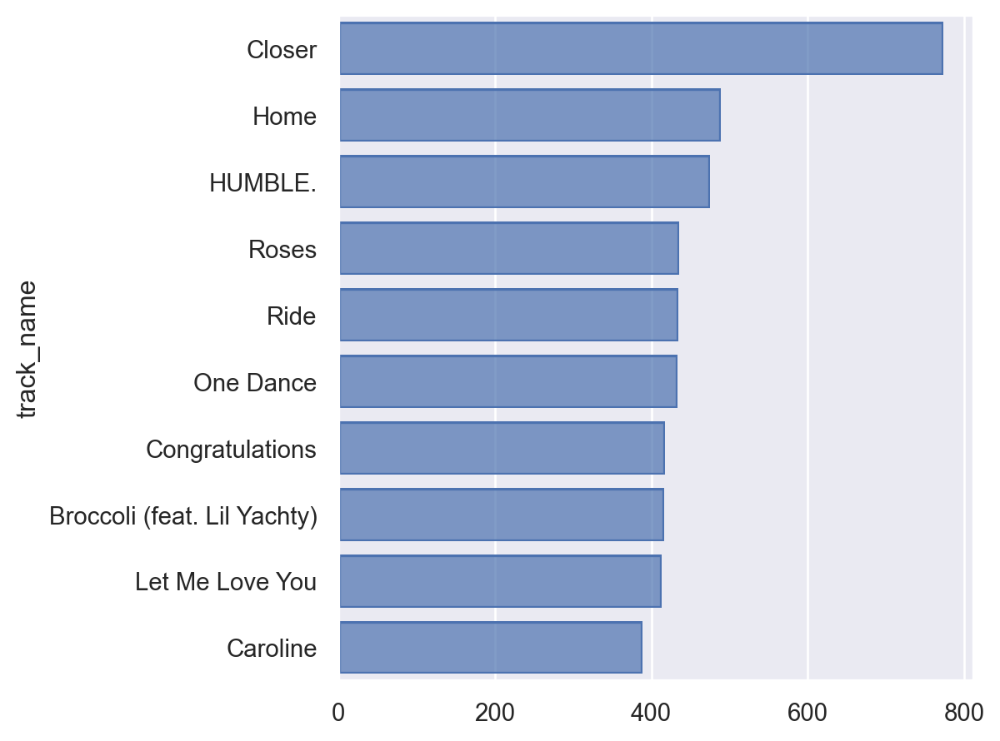

In [52]:
# what are the top 10 tracks that appear in these playlists most frequently?
top_10_tracks = expanded_df["track_name"].value_counts(ascending=False).head(10)
so.Plot(x=top_10_tracks.values, y=top_10_tracks.index).add(so.Bar())

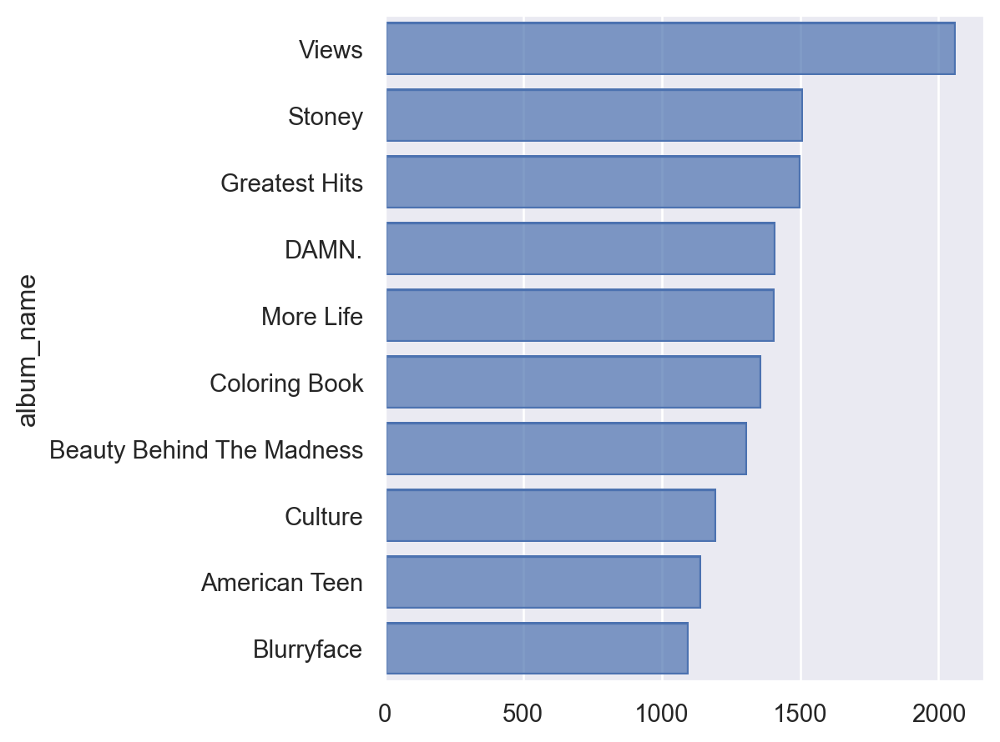

In [53]:
# what are the top 10 albums that appear in these playlists most frequently?
top_10_albums = expanded_df["album_name"].value_counts(ascending=False).head(10)
so.Plot(x=top_10_albums.values, y=top_10_albums.index).add(so.Bar())

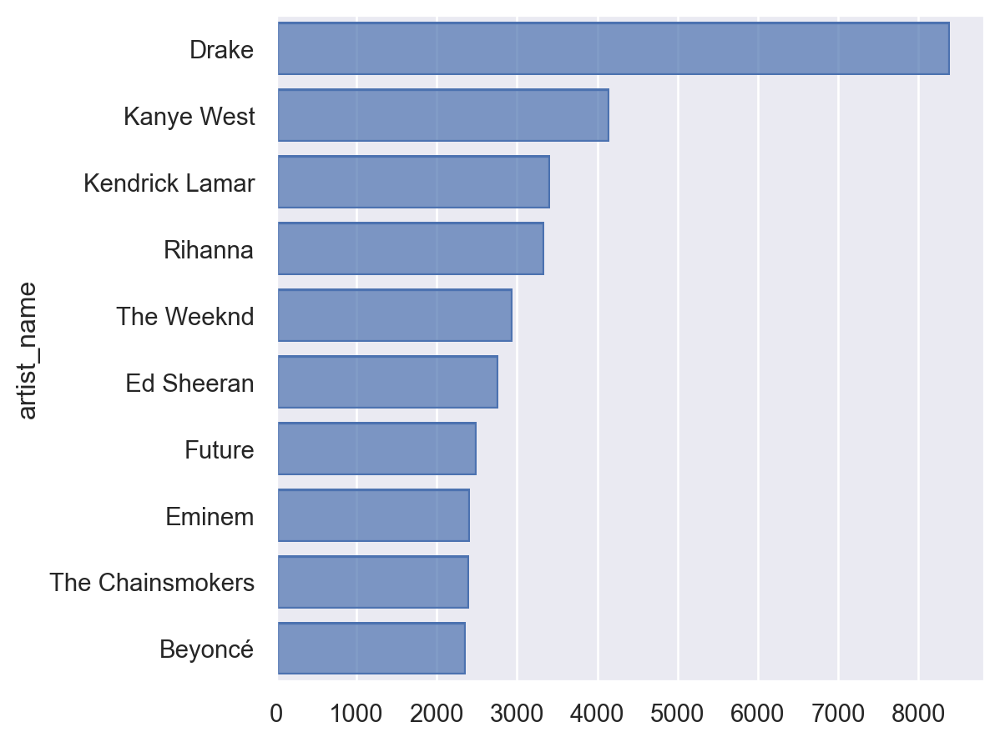

In [54]:
# what are the top 10 artists that appear in these playlists most frequently?
top_10_artists = expanded_df["artist_name"].value_counts(ascending=False).head(10)
so.Plot(x=top_10_artists.values, y=top_10_artists.index).add(so.Bar())

Trying to get song snippets for potential neural net... come back to this later

In [55]:
#! pip install spotipy

In [56]:
''' looking to see if we can get 30-second preview clips of each song to input into a neural net
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials

def get_audio_preview(uri):
    client_credentials_manager = SpotifyClientCredentials(client_id='d0dfd3852f9c4051a953200401ff4806',
                                                          client_secret='33f6107ae78c4beaa50d2827315adeaa')
    sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)
    
    track_id = uri.split(':')[-1]
    track_info = sp.track(track_id)
    
    audio_preview_url = track_info['preview_url']
    return audio_preview_url
    '''

" looking to see if we can get 30-second preview clips of each song to input into a neural net\nimport spotipy\nfrom spotipy.oauth2 import SpotifyClientCredentials\n\ndef get_audio_preview(uri):\n    client_credentials_manager = SpotifyClientCredentials(client_id='d0dfd3852f9c4051a953200401ff4806',\n                                                          client_secret='33f6107ae78c4beaa50d2827315adeaa')\n    sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)\n    \n    track_id = uri.split(':')[-1]\n    track_info = sp.track(track_id)\n    \n    audio_preview_url = track_info['preview_url']\n    return audio_preview_url\n    "

In [57]:
'''# testing out getting the urls
audio_preview_url = get_audio_preview('spotify:track:5uCax9HTNlzGybIStD3vDh')
audio_preview_url'''

"# testing out getting the urls\naudio_preview_url = get_audio_preview('spotify:track:5uCax9HTNlzGybIStD3vDh')\naudio_preview_url"

In [58]:
#expanded_df['audio_preview_url'] = expanded_df['track_uri'].apply(get_audio_preview)

# Baseline Model using Surprise

In [59]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder, OneHotEncoder, StandardScaler
from sklearn.neighbors import KNeighborsClassifier, NearestNeighbors
from sklearn.model_selection import train_test_split, KFold
from sklearn.pipeline import Pipeline
from scipy.sparse import csr_matrix

In [60]:
import surprise
from surprise.model_selection import train_test_split
from surprise.prediction_algorithms import *

In [61]:
limited_expanded_df = expanded_df[['playlist_name', 'track_and_artist', 'pos']]
limited_expanded_df.head()

,playlist_name,track_and_artist,pos
0,party party,'ABC' by The Jackson 5,0
0,party party,'Point/Counterpoint' by Streetlight Manifesto,1
0,party party,'Billie Jean' by Michael Jackson,2
0,party party,'Basket Case' by Green Day,3
0,party party,'Seven Nation Army' by The White Stripes,4


In [72]:
# converting this df into a surprise dataset
reader = surprise.Reader() 
data = surprise.Dataset.load_from_df(limited_expanded_df[['playlist_name', 'track_and_artist', 'pos']], reader)

In [76]:
# train-tst split using surprise
train, test = surprise.model_selection.train_test_split(data, random_state=27)
train

## KNN using surprise

In [64]:
model1 = KNNBasic().fit(train)

Computing the msd similarity matrix...
Done computing similarity matrix.


In [65]:
model1.test(test)[:5]

[Prediction(uid='CHL', iid="'Riptide' by Vance Joy", r_ui=31.0, est=5, details={'actual_k': 40, 'was_impossible': False}),
 Prediction(uid='Anything', iid="'We Will Rock You - Remastered' by Queen", r_ui=74.0, est=5, details={'actual_k': 40, 'was_impossible': False}),
 Prediction(uid='🔥🔥', iid="'Homie (feat. Meek Mill)' by Young Thug", r_ui=29.0, est=5, details={'actual_k': 6, 'was_impossible': False}),
 Prediction(uid='Slay', iid="'Time' by Lauren Sanderson", r_ui=43.0, est=5, details={'was_impossible': True, 'reason': 'User and/or item is unknown.'}),
 Prediction(uid='Invincible', iid="'Kryptonite' by 3 Doors Down", r_ui=22.0, est=5, details={'actual_k': 40, 'was_impossible': False})]

In [66]:
print(f"Mean Absolute Error: {surprise.accuracy.mae(model1.test(test))}")
print(f"Root Mean Squared Error: {surprise.accuracy.rmse(model1.test(test))}")

MAE:  49.8309
Mean Absolute Error: 49.83090399661375
RMSE: 69.0345
Root Mean Squared Error: 69.03451502703892


## SVD using surprise

In [67]:
model2 = SVD().fit(train)

In [68]:
model2.test(test)[:5]

[Prediction(uid='CHL', iid="'Riptide' by Vance Joy", r_ui=31.0, est=5, details={'was_impossible': False}),
 Prediction(uid='Anything', iid="'We Will Rock You - Remastered' by Queen", r_ui=74.0, est=5, details={'was_impossible': False}),
 Prediction(uid='🔥🔥', iid="'Homie (feat. Meek Mill)' by Young Thug", r_ui=29.0, est=5, details={'was_impossible': False}),
 Prediction(uid='Slay', iid="'Time' by Lauren Sanderson", r_ui=43.0, est=5, details={'was_impossible': False}),
 Prediction(uid='Invincible', iid="'Kryptonite' by 3 Doors Down", r_ui=22.0, est=5, details={'was_impossible': False})]

In [69]:
print(f"Mean Absolute Error: {surprise.accuracy.mae(model2.test(test))}")
print(f"Root Mean Squared Error: {surprise.accuracy.rmse(model2.test(test))}")

MAE:  49.8043
Mean Absolute Error: 49.80430694707705
RMSE: 69.0128
Root Mean Squared Error: 69.01284140931621


# DOING SOMETHING DIFFERENT HERE
This portion was created with insp from https://beckernick.github.io/music_recommender/

In [83]:
# in order to use the same train and test sets, convert surprise trainset back to a DataFrame we can use with other packages
# Convert trainset to DataFrame
train_df = pd.DataFrame(train.all_ratings(), columns=['playlist_name', 'track_and_artist', 'pos'])
# Retrieve the original playlist names from the trainset
train_df['playlist_name'] = [train_df.to_raw_uid(uid) for uid in train_df['playlist_name']]

# Convert testset to DataFrame
test_df = pd.DataFrame(test, columns=['playlist_name', 'track_and_artist', 'pos'])
# Retrieve the original playlist names from the testset
test_df['playlist_name'] = [test_df.to_raw_uid(uid) for uid in test_df['playlist_name']]

train_df.head()

AttributeError: 'DatasetAutoFolds' object has no attribute 'to_raw_uid'

In [70]:
'''
# in order to use the same train and test sets, convert surprise trainset back to a DataFrame we can use with other packages
# Retrieve the original playlist names from the Surprise trainset
train_playlist_ids = [train.to_raw_uid(uid) for uid in train.all_users()]
train_playlist_names = [data.df.loc[data.raw_to_inner_uid(uid), 'playlist_name'] for uid in train_playlist_ids]

# Retrieve the original playlist names from the Surprise testset
test_playlist_ids = [test.to_raw_uid(uid) for uid in test.all_users()]
test_playlist_names = [data.df.loc[data.raw_to_inner_uid(uid), 'playlist_name'] for uid in test_playlist_ids]

# Convert trainset to DataFrame
train_df = pd.DataFrame(train.all_ratings(), columns=['playlist_name', 'track_and_artist', 'pos'])
train_df['playlist_name'] = train_playlist_names

# Convert testset to DataFrame
test_df = pd.DataFrame(test, columns=['playlist_name', 'track_and_artist', 'pos'])
test_df['playlist_name'] = test_playlist_names

train_df.head()
'''

AttributeError: 'DatasetAutoFolds' object has no attribute 'raw_to_inner_uid'

In [ ]:
'''# in order to use the same train and test sets, convert surprise trainset back to a DataFrame we can use with other packages
train_df = pd.DataFrame(train.all_ratings(), columns=['playlist_name', 'track_and_artist', 'pos'])
test_df = pd.DataFrame(test, columns=['playlist_name', 'track_and_artist', 'pos'])
train_df.head()'''

In [ ]:
# creating a pivot table
train_pivot = pd.pivot_table(train_df, values='pos', index='playlist_name', columns='track_and_artist').fillna(0)
# sparse matrix
train_pivot_matrix = csr_matrix(train_pivot.values)
# repeating for test_df
test_pivot = pd.pivot_table(test_df, values='pos', index='playlist_name', columns='track_and_artist').fillna(0)
# sparse matrix
test_pivot_matrix = csr_matrix(test_pivot.values)

In [ ]:
train_pivot.head()

In [ ]:
train_pivot_matrix

In [ ]:
# instantiate model
model_knn = NearestNeighbors(metric='cosine', algorithm='brute')
# fit to matrix
model_knn.fit(train_pivot_matrix)

In [ ]:
#model_knn.score(test_pivot_matrix)

In [ ]:
query_index = np.random.choice(train_pivot_matrix.shape[0])

distances, indices = model_knn.kneighbors(train_pivot.iloc[query_index, :].values.reshape(1, -1), n_neighbors=21)

for i in range(0, len(distances.flatten())):
    if i ==0:
        print('Recommendations for "{0}": \n'.format(train_pivot.index[query_index]))
    else: 
        print('{0}: {1}, with distance of {2}'.format(i, train_pivot.columns[indices.flatten()[i]], distances.flatten()[i]))